SELEÇÃO DO ARQUIVO DE DADOS

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving dadosSemSol.json to dadosSemSol.json


IMPORTANDO OS DADOS

In [ ]:
import pandas as pd
import json
file_name = "dadosSemSol.json"
uploaded[file_name].decode("utf-8")

'{\n  "readings" : [\n    {\n  "timesTamp":  "2022-9-11 05:00:00",\n    "co2SGP": "445",\n    "humBME": "63.8",\n    "pressBME": "1015.04",\n    "sgpTVOC": "153",\n    "tempBME": "30.97",\n    "tempSHT31": "3102",\n    "tlsLUX": "0"\n  },{\n  "timesTamp":  "2022-9-11 05:00:02",\n    "co2SGP": "435",\n    "humBME": "63.8",\n    "pressBME": "1015.05",\n    "sgpTVOC": "146",\n    "tempBME": "30.93",\n    "tempSHT31": "3102",\n    "tlsLUX": "0"\n  },{\n  "timesTamp":  "2022-9-11 05:00:04",\n    "co2SGP": "443",\n    "humBME": "63.8",\n    "pressBME": "1015.04",\n    "sgpTVOC": "154",\n    "tempBME": "30.88",\n    "tempSHT31": "3101",\n    "tlsLUX": "0"\n  },{\n  "timesTamp":  "2022-9-11 05:00:10",\n    "co2SGP": "432",\n    "humBME": "63.8",\n    "pressBME": "1015.04",\n    "sgpTVOC": "146",\n    "tempBME": "30.87",\n    "tempSHT31": "3101",\n    "tlsLUX": "0"\n  },{\n  "timesTamp":  "2022-9-11 05:00:11",\n    "co2SGP": "439",\n    "humBME": "63.4",\n    "pressBME": "1015.05",\n    "sgpTVO

TRANSFORMANDO OS DADOS EM DATAFRAME

In [ ]:
df = pd.read_json('dadosSemSol.json', orient='index')
df.head()

,0,1,2,3,4,5,6,7,8,9,...,76519,76520,76521,76522,76523,76524,76525,76526,76527,76528
readings,"{'timesTamp': '2022-9-11 05:00:00', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:02', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:04', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:10', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:11', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:14', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:15', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:22', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:27', 'co2SGP': ...","{'timesTamp': '2022-9-11 05:00:29', 'co2SGP': ...",...,"{'timesTamp': '2022-9-13 16:59:31', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:33', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:39', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:45', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:47', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:49', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:50', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:52', 'co2SGP': ...","{'timesTamp': '2022-9-13 16:59:58', 'co2SGP': ...","{'timesTamp': '2022-9-13 17:00:00', 'co2SGP': ..."


In [ ]:
SUPERCOLUMN = 76529

TORNANDO O DATAFRAME EM ARRAY NUMPY

In [ ]:
import numpy as np
arr = df.to_numpy()
print('\nNumpy Array\n----------\n', arr[0][0])
print('\nNumpy Array Datatype :', arr.dtype)


Numpy Array
----------
 {'timesTamp': '2022-9-11 05:00:00', 'co2SGP': '445', 'humBME': '63.8', 'pressBME': '1015.04', 'sgpTVOC': '153', 'tempBME': '30.97', 'tempSHT31': '3102', 'tlsLUX': '0'}

Numpy Array Datatype : object


TRANSFORMANDO O JSON EM ARRAYS

In [ ]:
import json
from json import JSONEncoder
import numpy

class NumpyArrayEncoder(JSONEncoder):
    def default(self, obj):
        if isinstance(obj, numpy.ndarray):
            return obj.tolist()
        return JSONEncoder.default(self, obj)

numpyArrayOne = arr

# Serialization
numpyData = {"array": numpyArrayOne}
encodedNumpyData = json.dumps(numpyData, cls=NumpyArrayEncoder)  # use dump() to write array into file
print("Printing JSON serialized NumPy array")
print(encodedNumpyData)

# Deserialization
print("Decode JSON serialized NumPy array")
decodedArrays = json.loads(encodedNumpyData)

finalNumpyArray = numpy.asarray(decodedArrays["array"])
print("NumPy Array")
print(finalNumpyArray[0][5])



IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
def functionToGetDataFromArray(element):
  listData = []
  j = 0
  for n in finalNumpyArray[0]:
    numpyData3 = {"array": finalNumpyArray[0][j]}
    listData.append(numpyData3['array'][element])
    j = j+1
  numpyData2 = {"array": finalNumpyArray[0][0]}
  encodedNumpyData = json.dumps(numpyData2, cls=NumpyArrayEncoder)  # use dump() to write array into file
  print("Decode JSON serialized NumPy array")
  decodedArrays = json.loads(encodedNumpyData)
  return listData

In [ ]:

timesTamp = functionToGetDataFromArray('timesTamp')
co2SGP = functionToGetDataFromArray('co2SGP')
humBME = functionToGetDataFromArray('humBME')
pressBME = functionToGetDataFromArray('pressBME')
sgpTVOC = functionToGetDataFromArray('sgpTVOC')
tempBME = functionToGetDataFromArray('tempBME')
tempSHT31 = functionToGetDataFromArray('tempSHT31')
tlsLUX = functionToGetDataFromArray('tlsLUX')
print(timesTamp)
print(co2SGP)
print(sgpTVOC)
print(humBME)
print(pressBME)
print(tempBME)
print(tempSHT31)
print(tlsLUX)

Decode JSON serialized NumPy array
Decode JSON serialized NumPy array
Decode JSON serialized NumPy array
Decode JSON serialized NumPy array
Decode JSON serialized NumPy array
Decode JSON serialized NumPy array


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
print(timesTamp)
print(timesTamp[1][7], timesTamp[1][5])
number = ((int(timesTamp[0][10])*10 + int(timesTamp[0][11])) * 60) + (int(timesTamp[0][13])*10 + int(timesTamp[0][14]))
print(number)

['2022-9-11 05:00:00', '2022-9-11 05:00:02', '2022-9-11 05:00:04', '2022-9-11 05:00:10', '2022-9-11 05:00:11', '2022-9-11 05:00:14', '2022-9-11 05:00:15', '2022-9-11 05:00:22', '2022-9-11 05:00:27', '2022-9-11 05:00:29', '2022-9-11 05:00:31', '2022-9-11 05:00:33', '2022-9-11 05:00:35', '2022-9-11 05:00:41', '2022-9-11 05:00:43', '2022-9-11 05:00:45', '2022-9-11 05:00:47', '2022-9-11 05:00:49', '2022-9-11 05:00:54', '2022-9-11 05:00:56', '2022-9-11 05:00:58', '2022-9-11 05:01:00', '2022-9-11 05:01:02', '2022-9-11 05:01:08', '2022-9-11 05:01:10', '2022-9-11 05:01:12', '2022-9-11 05:01:14', '2022-9-11 05:01:16', '2022-9-11 05:01:21', '2022-9-11 05:01:23', '2022-9-11 05:01:24', '2022-9-11 05:01:26', '2022-9-11 05:01:28', '2022-9-11 05:01:34', '2022-9-11 05:01:36', '2022-9-11 05:01:38', '2022-9-11 05:01:40', '2022-9-11 05:01:42', '2022-9-11 05:01:48', '2022-9-11 05:01:50', '2022-9-11 05:01:51', '2022-9-11 05:01:53', '2022-9-11 05:01:55', '2022-9-11 05:02:01', '2022-9-11 05:02:04', '2022-9-1

In [ ]:
print(timesTamp)
# print(timesTamp[1][9], timesTamp[1][10])
# number = ((int(timesTamp[0][9])*10 + int(timesTamp[0][10])) * 60) + (int(timesTamp[0][12])*10 + int(timesTamp[0][13]))
# print(number)
lines = 0
columns = 0
cincoHoras = 5
dezesseteHoras = 17
while columns < SUPERCOLUMN:
  #number = ((int(timesTamp[columns][9])*10 + int(timesTamp[columns][10])) * 60) + (int(timesTamp[columns][12])*10 + int(timesTamp[columns][13]))
  number = (int(timesTamp[columns][10])*10 + int(timesTamp[columns][11]))
  # if(int(timesTamp[columns][7]) == 7):
    # if(number > dezesseteHoras):
    #   print("stop line: ", columns)
  
  #print(timesTamp[columns])
  if(number >= cincoHoras):
    if(number <= dezesseteHoras):
      timesTamp[columns] = 'DIA'
    else:
      timesTamp[columns] = 'NOITE'
  else:
    timesTamp[columns] = 'NOITE'
  
  columns = columns + 1
  if(lines >= SUPERCOLUMN):
    break;


['2022-9-11 05:00:00', '2022-9-11 05:00:02', '2022-9-11 05:00:04', '2022-9-11 05:00:10', '2022-9-11 05:00:11', '2022-9-11 05:00:14', '2022-9-11 05:00:15', '2022-9-11 05:00:22', '2022-9-11 05:00:27', '2022-9-11 05:00:29', '2022-9-11 05:00:31', '2022-9-11 05:00:33', '2022-9-11 05:00:35', '2022-9-11 05:00:41', '2022-9-11 05:00:43', '2022-9-11 05:00:45', '2022-9-11 05:00:47', '2022-9-11 05:00:49', '2022-9-11 05:00:54', '2022-9-11 05:00:56', '2022-9-11 05:00:58', '2022-9-11 05:01:00', '2022-9-11 05:01:02', '2022-9-11 05:01:08', '2022-9-11 05:01:10', '2022-9-11 05:01:12', '2022-9-11 05:01:14', '2022-9-11 05:01:16', '2022-9-11 05:01:21', '2022-9-11 05:01:23', '2022-9-11 05:01:24', '2022-9-11 05:01:26', '2022-9-11 05:01:28', '2022-9-11 05:01:34', '2022-9-11 05:01:36', '2022-9-11 05:01:38', '2022-9-11 05:01:40', '2022-9-11 05:01:42', '2022-9-11 05:01:48', '2022-9-11 05:01:50', '2022-9-11 05:01:51', '2022-9-11 05:01:53', '2022-9-11 05:01:55', '2022-9-11 05:02:01', '2022-9-11 05:02:04', '2022-9-1

In [ ]:


# lines = 0
# columns = 0
# cincoHoras = 5 * 60
# dezesseteHoras = 17 * 60
# while columns < SUPERCOLUMN:

#   if(timesTamp[columns] != 'DIA'):
#     if(timesTamp[columns] != 'NOITE'):
#       number = ((int(timesTamp[columns][9])*10 + int(timesTamp[columns][10])) * 60) 
#       if(number > 5):
#         if(number <17):
#           timesTamp[columns] = 'DIA'
#         elif(number == 17):
#           number = (int(timesTamp[columns][12])*10 + int(timesTamp[columns][13]))
#           if(number == 0):
#             timesTamp[columns] = 'DIA'
#           else:
#             timesTamp[columns] = 'NOITE'
#         else:
#           timesTamp[columns] = 'NOITE'
#       elif(number < 5):
#         timesTamp[columns] = 'NOITE'
#       else:
#         number = (int(timesTamp[columns][12])*10 + int(timesTamp[columns][13]))
#         if(number >= 0):
#           timesTamp[columns] = 'DIA'
#   columns = columns + 1
# print(timesTamp)

In [ ]:
print(timesTamp)

['DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA', 'DIA'

In [ ]:
# https://www.adamsmith.haus/python/answers/how-to-add-a-column-to-a-pandas-dataframe-from-a-list-in-python#:~:text=Use%20DataFrame%20indexing%20to%20add,element%20in%20list%20to%20pd.
# print do dataframe original
from numpy import random
data_array = random.randint(100, size=(SUPERCOLUMN, 4))
lines = 0
columns = 0
while(lines < SUPERCOLUMN):
    # data_array[lines][0] = timesTamp[lines]
    data_array[lines][0] = co2SGP[lines]
    data_array[lines][1] = sgpTVOC[lines]
    # data_array[lines][2] = int(float(pressBME[lines]))tlsLUX
    # data_array[lines][3] = int(float(tempBME[lines]))
    data_array[lines][2] = tlsLUX[lines]
    # data_array[lines][5] = int(float(humBME[lines]))
    data_array[lines][3] = tempSHT31[lines]
    lines = lines + 1
column_names = ["co2", "tvoc", "lux","temperatureSHT31"]
data_df = pd.DataFrame(data_array, columns=column_names)
data_df["temperatureBME"] = tempBME
data_df["humidity"] = humBME
data_df["pressure"] = pressBME
data_df["timesTamp"] = timesTamp
data_df.head(SUPERCOLUMN)

,co2,tvoc,lux,temperatureSHT31,temperatureBME,humidity,pressure,timesTamp
0,445,153,0,3102,30.97,63.8,1015.04,DIA
1,435,146,0,3102,30.93,63.8,1015.05,DIA
2,443,154,0,3101,30.88,63.8,1015.04,DIA
3,432,146,0,3101,30.87,63.8,1015.04,DIA
4,439,156,0,3102,31.13,63.4,1015.05,DIA
...,...,...,...,...,...,...,...,...
76524,543,384,100,3156,31.44,64.9,1013.53,DIA
76525,545,378,100,3158,31.39,64.8,1013.53,DIA
76526,542,371,100,3159,31.38,64.8,1013.53,DIA
76527,552,381,100,3162,31.37,64.8,1013.54,DIA


In [ ]:
# https://www.adamsmith.haus/python/answers/how-to-add-a-column-to-a-pandas-dataframe-from-a-list-in-python#:~:text=Use%20DataFrame%20indexing%20to%20add,element%20in%20list%20to%20pd.
from numpy import random
data_array = random.randint(100, size=(SUPERCOLUMN, 7))
lines = 0
columns = 0
while(lines < SUPERCOLUMN):
    # data_array[lines][0] = timesTamp[lines]
    data_array[lines][0] = co2SGP[lines]
    data_array[lines][1] = sgpTVOC[lines]
    data_array[lines][2] = int(float(pressBME[lines]))
    data_array[lines][3] = int(float(tempBME[lines]))
    data_array[lines][4] = tlsLUX[lines]
    data_array[lines][5] = int(float(humBME[lines]))
    data_array[lines][6] = tempSHT31[lines]
    lines = lines + 1
column_names = ["co2", "tvoc","pressure","temperatureBME", "lux","humidity", "temperatureSHT31"]
data_df = pd.DataFrame(data_array, columns=column_names)
# data_df["temperatureBME"] = tempBME
#data_df["humidity"] = humBME
# data_df["pressure"] = pressBME
data_df["timesTamp"] = timesTamp
# lista = []
# lines = 0
# while(lines < SUPERCOLUMN):
#   lista.append(lines)
#   lines = lines + 1
# print(lista)
data_df.head(SUPERCOLUMN)

,co2,tvoc,pressure,temperatureBME,lux,humidity,temperatureSHT31,timesTamp
0,445,153,1015,30,0,63,3102,DIA
1,435,146,1015,30,0,63,3102,DIA
2,443,154,1015,30,0,63,3101,DIA
3,432,146,1015,30,0,63,3101,DIA
4,439,156,1015,31,0,63,3102,DIA
...,...,...,...,...,...,...,...,...
76524,543,384,1013,31,100,64,3156,DIA
76525,545,378,1013,31,100,64,3158,DIA
76526,542,371,1013,31,100,64,3159,DIA
76527,552,381,1013,31,100,64,3162,DIA


In [ ]:
lista = []
lines = 0
while(lines < SUPERCOLUMN ):
  lista.append(lines)
  lines = lines + 1
data_df["index"] = lista
data_df.set_index('index')


,co2,tvoc,pressure,temperatureBME,lux,humidity,temperatureSHT31,timesTamp
index,,,,,,,,
0,445,153,1015,30,0,63,3102,DIA
1,435,146,1015,30,0,63,3102,DIA
2,443,154,1015,30,0,63,3101,DIA
3,432,146,1015,30,0,63,3101,DIA
4,439,156,1015,31,0,63,3102,DIA
...,...,...,...,...,...,...,...,...
76524,543,384,1013,31,100,64,3156,DIA
76525,545,378,1013,31,100,64,3158,DIA
76526,542,371,1013,31,100,64,3159,DIA


CALCULO DA CORRELAÇÃO ENTRE OS PARÂMETROS:
https://medium.com/omixdata/estat%C3%ADstica-an%C3%A1lise-de-correla%C3%A7%C3%A3o-usando-python-e-r-d68611511b5a#:~:text=O%20coeficiente%20de%20Pearson%2C%20tamb%C3%A9m,valores%20entre%20%2D1%20e%201.

https://www.delftstack.com/pt/howto/python-pandas/pandas-correlation-matrix/

https://www.questionpro.com/blog/pt-br/correlacao-de-pearson/

https://queirozf.com/entries/pandas-dataframe-plot-examples-with-matplotlib-pyplot#scatter-plot-of-two-columns

Valor = -1 -> Correlação linear perfeita negativa
Valor = 1 -> Correlação linear perfeita positiva
Valor = 0 -> Auxência de relacionamento linear. Os parâmetros não mostram "alinhamento". Correlação **NULA**
-1 < Valor < 0 -> Correlação negativa (x sobe; y desce)
0 < Valor < 1 -> Correlação positiva (x sobe; y sobe)

Teoria sobre os testes de correlação:
http://www.mat.ufrgs.br/~viali/pg/material/laminaspime/CRS_6.pdf


In [ ]:
#CALCULO DA MÉDIA E DA MEDIANA
print(data_df.describe())

                co2          tvoc      pressure  temperatureBME           lux  \
count  76529.000000  76529.000000  76529.000000    76529.000000  76529.000000   
mean     457.252493    207.568686   1014.524141       30.977878     59.806087   
std       57.964523    100.048707      1.263189        0.600473    137.413779   
min      400.000000     54.000000   1013.000000       29.000000      0.000000   
25%      423.000000    162.000000   1013.000000       31.000000      0.000000   
50%      451.000000    197.000000   1014.000000       31.000000      0.000000   
75%      483.000000    238.000000   1015.000000       31.000000    100.000000   
max     3674.000000   5124.000000   1017.000000       33.000000   2400.000000   

           humidity  temperatureSHT31         index  
count  76529.000000      76529.000000  76529.000000  
mean      61.072979       3149.489906  38264.000000  
std        1.792641         53.253161  22092.163713  
min       54.000000       2990.000000      0.000000  


Valores do coeficiente de correlação de Pearson: 
                       co2      tvoc  pressure  temperatureBME       lux  \
co2               1.000000  0.863261 -0.161288        0.202640  0.116152   
tvoc              0.863261  1.000000 -0.241199        0.191057  0.065565   
pressure         -0.161288 -0.241199  1.000000       -0.262590  0.010235   
temperatureBME    0.202640  0.191057 -0.262590        1.000000  0.297099   
lux               0.116152  0.065565  0.010235        0.297099  1.000000   
humidity          0.039687 -0.037912  0.225823       -0.532398 -0.218266   
temperatureSHT31  0.277292  0.260885 -0.358270        0.772658  0.321451   
index             0.289918  0.331681 -0.589136        0.134389  0.087594   

                  humidity  temperatureSHT31     index  
co2               0.039687          0.277292  0.289918  
tvoc             -0.037912          0.260885  0.331681  
pressure          0.225823         -0.358270 -0.589136  
temperatureBME   -0.532398          0

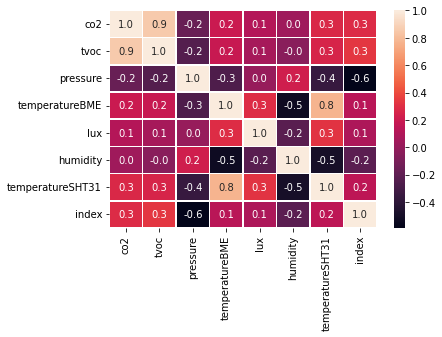

In [ ]:
# Calculo da correlação entre os parâmetros
import seaborn as sn
correlation = data_df.corr(method='pearson')
print("Valores do coeficiente de correlação de Pearson: ")
print(correlation, "\n")
print("Pode-se perceber que a relação linear mais forte é entre co2 e tvoc.")
plot = sn.heatmap(correlation, annot = True, fmt=".1f", linewidths=.6)
plot

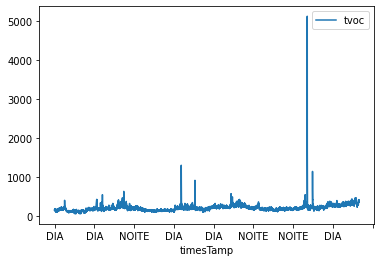

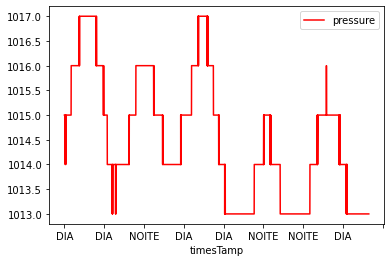

In [ ]:
import matplotlib.pyplot as plt # Impot the relevant module
# fig, ax = plt.subplots() # Create the figure and axes object
# data_df.plot(x = 'timesTamp', y = 'tvoc', ax = ax) 
# data_df.plot(x = 'timesTamp', y = 'pressure', ax = ax, secondary_y = True) 

data_df.plot(x ='timesTamp', y='tvoc', kind = 'line')
data_df.plot(x ='timesTamp', y='pressure', color = 'red', kind = 'line')
plt.show()

CICLO DIA NOITE

In [ ]:
# lines = 0
# soma= 0
# idxNoite = 0
# qtdSomada = 0
# # while(lines < SUPERCOLUMN):
# #   if(timesTamp[lines] == 'NOITE'):
# #     break;
# #   lines += 1
# # print("lines1: ",lines)



# #lines = 0
# soma= 0
# soma2 = 0
# idxNoite = 0
# qtdSomada = 0
# while(lines < SUPERCOLUMN):
#   if(timesTamp[lines] == 'DIA'):
#     soma = soma + int(sgpTVOC[lines])
#     soma2 = soma2 + int(humBME[lines])
#     qtdSomada = qtdSomada + 1
#   elif(timesTamp[lines] == 'NOITE'):
#     idxNoite = lines
#     break
#   lines += 1
  
# print(soma)
# mediaDia1 = soma/qtdSomada
# media2Dia1 = soma2/qtdSomada
# print(mediaDia1)
# print(idxNoite)

# lines = idxNoite
# soma= 0
# soma2 = 0
# idxNoite = 0
# idxDia2 = 0
# qtdSomada = 0
# while(lines < SUPERCOLUMN):
#   if(timesTamp[lines] == 'DIA'):
#     soma = soma + int(sgpTVOC[lines])
#     soma2 = soma2 + int(humBME[lines])
#     qtdSomada = qtdSomada + 1
#   elif(timesTamp[lines] == 'NOITE'):
#       idxDia2 = lines
#       break
#   lines += 1
  
# print(soma)
# mediaDia2 = soma/qtdSomada
# media2Dia2 = soma2/qtdSomada
# print(mediaDia2)

# lines = idxDia2
# soma= 0
# soma2 = 0
# idxNoite = 0
# idxDia2 = 0
# qtdSomada = 0
# while(lines < SUPERCOLUMN):
#   if(timesTamp[lines] == 'DIA'):
#     soma = soma + int(sgpTVOC[lines])
#     soma2 = soma2 + int(humBME[lines])
#     qtdSomada = qtdSomada + 1
#   elif(timesTamp[lines] == 'NOITE'):
#       idxNoite = lines
#       break
#   lines += 1
  
# print(soma)
# mediaDia3 = soma/qtdSomada
# media2Dia3 = soma2/qtdSomada
# print(mediaDia3)

# lines = idxNoite
# soma= 0
# soma2 = 0
# idxNoite = 0
# idxDia2 = 0
# qtdSomada = 0
# while(lines < SUPERCOLUMN):
#   if(timesTamp[lines] == 'DIA'):
#     soma = soma + int(sgpTVOC[lines])
#     soma2 = soma2 + int(humBME[lines])
#     qtdSomada = qtdSomada + 1
#   elif(timesTamp[lines] == 'NOITE'):
#       idxDia2 = lines
#       break
#   lines += 1
  
# print(soma)
# mediaDia4 = soma/qtdSomada
# media2Dia4 = soma2/qtdSomada
# print(mediaDia4)

In [ ]:
lines = 0
soma= 0
soma2 = 0
idxNoite = 0
qtdSomada = 0
# while(lines < 84635):
#   if(timesTamp[lines] == 'NOITE'):
#     break;
#   lines += 1
# print("lines1: ",lines)



#lines = 0
soma= 0
soma2 = 0
soma3 = 0
soma4 = 0
soma5 = 0
idxNoite = 0
qtdSomada = 0
while(lines < SUPERCOLUMN):
  if(timesTamp[lines] == 'DIA'):
    soma = soma + int(sgpTVOC[lines])
    soma2 = soma2 + float(humBME[lines])
    soma3 = soma3 + float(tempBME[lines])
    soma4 = soma4 + float(pressBME[lines])
    soma5 = soma5 + float(tlsLUX[lines])
    qtdSomada = qtdSomada + 1
  elif(timesTamp[lines] == 'NOITE'):
    idxNoite = lines
    break
  lines += 1
  
print(soma)
mediaDia1 = soma/qtdSomada
media2Dia1 = soma2/qtdSomada
media3Dia1 = soma3/qtdSomada
media4Dia1 = soma4/qtdSomada
media5Dia1 = soma5/qtdSomada
print(mediaDia1)
print(idxNoite)

lines = idxNoite
soma= 0
soma2= 0
soma3 = 0
soma4 = 0
soma5 = 0
idxNoite = 0
idxDia2 = 0
qtdSomada = 0
while(lines < SUPERCOLUMN):
  if(timesTamp[lines] == 'NOITE'):
    soma = soma + int(sgpTVOC[lines])
    soma2 = soma2 + float(humBME[lines])
    soma3 = soma3 + float(tempBME[lines])
    soma4 = soma4 + float(pressBME[lines])
    soma5 = soma5 + float(tlsLUX[lines])
    qtdSomada = qtdSomada + 1
  elif(timesTamp[lines] == 'DIA'):
      idxDia2 = lines
      break
  lines += 1
  
print(soma)
mediaDia2 = soma/qtdSomada
media2Dia2 = soma2/qtdSomada
media3Dia2 = soma3/qtdSomada
media4Dia2 = soma4/qtdSomada
media5Dia2 = soma5/qtdSomada
print(mediaDia2)

lines = idxDia2
soma= 0
soma2=0
soma3 = 0
soma4 = 0
soma5 = 0
idxNoite = 0
idxDia2 = 0
qtdSomada = 0
while(lines < SUPERCOLUMN):
  if(timesTamp[lines] == 'DIA'):
    soma = soma + int(sgpTVOC[lines])
    soma2 = soma2 + float(humBME[lines])
    soma3 = soma3 + float(tempBME[lines])
    soma4 = soma4 + float(pressBME[lines])
    soma5 = soma5 + float(tlsLUX[lines])
    qtdSomada = qtdSomada + 1
  elif(timesTamp[lines] == 'NOITE'):
      idxNoite = lines
      break
  lines += 1
  
print(soma)
mediaDia3 = soma/qtdSomada
media2Dia3 = soma2/qtdSomada
media3Dia3 = soma3/qtdSomada
media4Dia3 = soma4/qtdSomada
media5Dia3 = soma5/qtdSomada
print(mediaDia3)

lines = idxNoite
soma= 0
soma2 = 0
soma3 = 0
soma4 = 0
soma5 = 0
idxNoite = 0
idxDia2 = 0
qtdSomada = 0
while(lines < SUPERCOLUMN):#84635):
  if(timesTamp[lines] == 'NOITE'):
    soma = soma + int(sgpTVOC[lines])
    soma2 = soma2 + float(humBME[lines])
    soma3 = soma3 + float(tempBME[lines])
    soma4 = soma4 + float(pressBME[lines])
    soma5 = soma5 + float(tlsLUX[lines])
    qtdSomada = qtdSomada + 1
  elif(timesTamp[lines] == 'DIA'):
      idxDia2 = lines
      break
  lines += 1
  
print(soma)
mediaDia4 = soma/qtdSomada
media2Dia4 = soma2/qtdSomada
media3Dia4 = soma3/qtdSomada
media4Dia4 = soma4/qtdSomada
media5Dia4 = soma5/qtdSomada
print(mediaDia4)

2449795
163.3632301947186
14996
2596150
179.7763312789973
3722075
219.86384310945715
2809699
198.35503000352983


In [ ]:

# mediaDia1 = mediaDia1/mediaDia2#DIA
# mediaDia2 = mediaDia2/mediaDia2#DIA
# mediaDia3 = mediaDia3/mediaDia2#NOITE
# mediaDia4 = mediaDia4/mediaDia2#DIA

# media2Dia1 = media2Dia1/media2Dia2
# media2Dia2 = media2Dia2/media2Dia2
# media2Dia3 = media2Dia3/media2Dia2
# media2Dia4 = media2Dia4/media2Dia2

# media3Dia1 = media3Dia1/media3Dia2
# media3Dia2 = media3Dia2/media3Dia2
# media3Dia3 = media3Dia3/media3Dia2
# media3Dia4 = media3Dia4/media3Dia2

# media4Dia1 = media4Dia1/media4Dia2
# media4Dia2 = media4Dia2/media4Dia2
# media4Dia3 = media4Dia3/media4Dia2
# media4Dia4 = media4Dia4/media4Dia2

# media5Dia1 = media5Dia1/media5Dia2
# media5Dia2 = media5Dia2/media5Dia2
# media5Dia3 = media5Dia3/media5Dia2
# media5Dia4 = media5Dia4/media5Dia2

In [ ]:
data_array = np. empty((4, 5), float)
print("DAY: ",mediaDia1)
print("NIGHT: ",mediaDia2)
print("DAY: ",mediaDia3)
print("NIGHT: ",mediaDia4)

# empty_array[0][0] = mediaDia4/mediaDia2
# print("data_array[3][0]: ",mediaDia4/mediaDia2)

DAY:  163.3632301947186
NIGHT:  179.7763312789973
DAY:  219.86384310945715
NIGHT:  198.35503000352983


In [ ]:
#PEGANDO OS DADOS ORIUNDOS DO ARQUIVO "COM PLANTA E COM SOL" PARA LER O TVOC
dividendoTVOC = 995.3932545796953

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

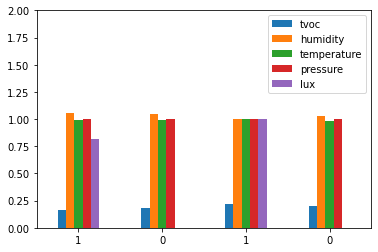

In [ ]:
data_array[0][0] = mediaDia1/dividendoTVOC#vocs
data_array[1][0] = mediaDia2/dividendoTVOC
data_array[2][0] = mediaDia3/dividendoTVOC
data_array[3][0] = mediaDia4/dividendoTVOC#mediaDia3

data_array[0][1] = media2Dia1/media2Dia3
data_array[1][1] = media2Dia2/media2Dia3
data_array[2][1] = media2Dia3/media2Dia3
data_array[3][1] = media2Dia4/media2Dia3

data_array[0][2] = media3Dia1/media3Dia3
data_array[1][2] = media3Dia2/media3Dia3
data_array[2][2] = media3Dia3/media3Dia3
data_array[3][2] = media3Dia4/media3Dia3

data_array[0][3] = media4Dia1/media4Dia3
data_array[1][3] = media4Dia2/media4Dia3
data_array[2][3] = media4Dia3/media4Dia3
data_array[3][3] = media4Dia4/media4Dia3

data_array[0][4] = media5Dia1/media5Dia3
data_array[1][4] = media5Dia2/media5Dia3
data_array[2][4] = media5Dia3/media5Dia3
data_array[3][4] = media5Dia4/media5Dia3
column_names = ["tvoc","humidity","temperature", "pressure", "lux"]
data_df = pd.DataFrame(data_array, columns=column_names)
lista = [1, 0,1,0]
data_df[""] = lista
data_df.head(4)
# data_df.plot.bar(x ='timesTamp', y='tvoc', rot = 0)
# data_df.plot.bar(x ='timesTamp', y='hum', rot = 0)
# data_df.plot.bar(x ='timesTamp', y='temp', rot = 0)
ax = data_df.plot.bar(x = '', rot=0)
plt.ylim((0,2))
plt.legend(loc='upper right')
#Baixar o gráfico em formato ".eps"
plt.savefig("figWPlant.eps")
files.download("figWPlant.eps")

In [ ]:
df_max_scaled = data_df.copy() 
for column in df_max_scaled.columns: 
    df_max_scaled[column] = df_max_scaled[column]  / df_max_scaled[column].abs().max() 
      
display(df_max_scaled)
lista = ["DAY", "NIGHT","DAY","NIGHT"]
data_df[""] = lista
ax = data_df.plot.bar(x = '', rot=0)
plt.ylim((0,2))
plt.legend(loc='upper right')
#Baixar o gráfico em formato ".eps"
plt.savefig("figWOPlant.eps")
files.download("figWOPlant.eps")

TypeError: ignored